In [ ]:
import scipy.io.wavfile

import torch
import numpy as np
from IPython import display
from matplotlib import pyplot as plt
%matplotlib inline

import random
from pathlib import Path

seed = 0
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.backends.cudnn.deterministic = True

In [ ]:
# Detect if we are in Google Colaboratory
try:
    import google.colab
    IN_COLAB = True
except ImportError:
    IN_COLAB = False

from pathlib import Path
# Determine the locations of auxiliary libraries and datasets.
# `AUX_DATA_ROOT` is where 'notmnist.py', 'animation.py' and 'tiny-imagenet-2020.zip' are.
if IN_COLAB:
    google.colab.drive.mount("/content/drive")
    
    # Change this if you created the shortcut in a different location
    AUX_DATA_ROOT = Path("/content/drive/My Drive/Deep Learning 2020 -- Home Assignment 4")
    
    assert AUX_DATA_ROOT.is_dir(), "Have you forgotten to 'Add a shortcut to Drive'?"
    
    import sys
    sys.path.insert(0, str(AUX_DATA_ROOT))
else:
    AUX_DATA_ROOT = Path(".")

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:
![ ! -d "LJ-Speech-aligned" ] && unzip -q "{AUX_DATA_ROOT / 'LJ-Speech-aligned.zip'}"
!git clone --recursive https://github.com/shrubb/waveglow.git -b denoiser-fix
!wget -c https://api.ngc.nvidia.com/v2/models/nvidia/waveglow_ljs_256channels/versions/2/files/waveglow_256channels_ljs_v2.pt

Cloning into 'waveglow'...
remote: Enumerating objects: 3, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 179 (delta 0), reused 2 (delta 0), pack-reused 176
Receiving objects: 100% (179/179), 433.68 KiB | 8.18 MiB/s, done.
Resolving deltas: 100% (98/98), done.
Submodule 'tacotron2' (https://github.com/shrubb/tacotron2.git) registered for path 'tacotron2'
Cloning into '/content/waveglow/tacotron2'...
remote: Enumerating objects: 399, done.        
remote: Total 399 (delta 0), reused 0 (delta 0), pack-reused 399        
Receiving objects: 100% (399/399), 2.69 MiB | 23.76 MiB/s, done.
Resolving deltas: 100% (202/202), done.
Submodule path 'tacotron2': checked out 'ed0f02bda932e6ab17f8f4b034ac26767a6a7a50'
--2020-05-24 08:38:19--  https://api.ngc.nvidia.com/v2/models/nvidia/waveglow_ljs_256channels/versions/2/files/waveglow_256channels_ljs_v2.pt
Resolving api.ngc.nvidia.com (api.ngc.nvidia.com)... 35.161.182.61, 52.89.201.137


In [ ]:
!pip install git+https://github.com/shrubb/listener.git

  Cloning https://github.com/shrubb/listener.git to /tmp/pip-req-build-rzrx8t1n
  Running command git clone -q https://github.com/shrubb/listener.git /tmp/pip-req-build-rzrx8t1n
  Created wheel for listener: filename=listener-1.0.0a1-cp36-none-any.whl size=87098 sha256=63fcc2485a59fead04e6d36a2bf0fa5f89babc1408f2e2f2ebf9b5a0bd25ebae
  Stored in directory: /tmp/pip-ephem-wheel-cache-a7l4qg0_/wheels/41/ec/98/7c89227ba5da35ff1e7d5284bb58e0b98e93389fc1f77c407b
Successfully built listener


In [ ]:
import lj_speech

In [ ]:
DATASET_ROOT = Path('LJ-Speech-aligned/')

train_dataset, val_dataset = lj_speech.get_dataset(DATASET_ROOT)

Here is an example datapoint:

Datasets yield: text, phonemes_start, phonemes_duration, phonemes_code, spectrogram


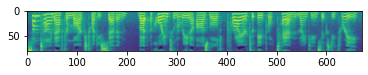

In [ ]:
example_datapoint = train_dataset[666]
print(f"Datasets yield: {', '.join(example_datapoint.keys())}")
plt.imshow(example_datapoint['spectrogram']);

In [ ]:
example_datapoint['spectrogram'].shape

(80, 671)

In [ ]:
#WaveGlow
vocoder = lj_speech.Vocoder()

In [ ]:
print(example_datapoint['text'])

example_spectrogram = torch.from_numpy(example_datapoint['spectrogram'])
audio = vocoder(example_spectrogram)
lj_speech.play_audio(audio)

sometime after march twenty-seven, but according to marina oswald, prior to april ten, nineteen sixty-three,


Finally, we have phonemes as inputs, but we'd like to synthesize arbitrary text. For that, there is a function `lj_speech.text_to_phonemes(text)`.

In [ ]:
lj_speech.text_to_phonemes('I love you')

[nltk_data] Downloading package cmudict to /root/nltk_data...
[nltk_data]   Unzipping corpora/cmudict.zip.


['AY1', 'L', 'AH1', 'V', 'Y', 'UW1']

## Method

Reimplement the baseline method defined by the diagram below. It's derived from a simplified version of the [DurIAN paper](https://arxiv.org/abs/1909.01700).



![pipeline](https://user-images.githubusercontent.com/9570420/81863803-6f0ba300-9574-11ea-9f02-481c2bba81f0.png)



In [ ]:
lj_speech.play_audio(scipy.io.wavfile.read(AUX_DATA_ROOT / 'ok.wav')[1])

**On the other hand, here is an example of insufficient quality:**

In [ ]:
lj_speech.play_audio(scipy.io.wavfile.read(AUX_DATA_ROOT / 'bad.wav')[1])

In [ ]:
import torch.nn as nn
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter
import os
from datetime import datetime
log_dir = './durian_runs'
os.makedirs(log_dir, exist_ok=True)

In [ ]:
PHONEME_CODES = lj_speech.POSSIBLE_PHONEME_CODES
NUMBER_PHONEMES = len(PHONEME_CODES)
phoneme2idx = dict(zip(sorted(list(PHONEME_CODES)), range(NUMBER_PHONEMES)))
idx2phoneme = dict(zip(range(NUMBER_PHONEMES), sorted(list(PHONEME_CODES))))
PADDING_IDX = phoneme2idx['pau']
MEL_NB_FREQUENCIES = example_spectrogram.shape[0]
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [ ]:
example_datapoint = val_dataset[0]
example_phonemes1 = torch.LongTensor([phoneme2idx[phoneme] for phoneme in example_datapoint['phonemes_code']])[None].cuda()
example_durations1 = torch.LongTensor(example_datapoint['phonemes_duration'])[None].cuda()
print('First text:\n\t', example_datapoint['text'])
example_datapoint = train_dataset[0]
example_phonemes2 = torch.LongTensor([phoneme2idx[phoneme] for phoneme in example_datapoint['phonemes_code']])[None].cuda()
example_durations2 = torch.LongTensor(example_datapoint['phonemes_duration'])[None].cuda()
print('Second text:\n\t', example_datapoint['text'])

First text:
	 the knowledge of his defection, his arrogance and hostility to the united states,
Second text:
	 he consistently refused to admit involvement in the assassination or in the killing of patrolman tippit.


In [ ]:
class SpeechDataset(torch.utils.data.Dataset):
    
    def __init__(self, dataset):
        super().__init__()
        self.dataset = dataset

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        point = self.dataset[idx]
        text = point['text']
        mel = torch.tensor(point['spectrogram'])
        phonemes = torch.LongTensor([phoneme2idx[phoneme] for phoneme in point['phonemes_code']])
        durations = torch.LongTensor(point['phonemes_duration'])
        return phonemes, durations, mel

true_train_dataset = SpeechDataset(train_dataset)
true_val_dataset = SpeechDataset(val_dataset)

In [ ]:
def pad_collate(batch):
    # batch contains a list of tuples of structure (sequence, target)
    pad_lengths = [item[2].shape[1] for item in batch]
    dur_lengths = [item[1].shape[0] for item in batch]

    max_length = max(pad_lengths)
    max_nb_of_phonemes = max([item[0].shape[0] for item in batch])
    phonemes_list = torch.stack([
                     torch.cat([item[0], torch.LongTensor((max_nb_of_phonemes-item[0].shape[0])*[PADDING_IDX])]) for item in batch
                     ])

    
    durations_list = torch.stack([
                     torch.cat([item[1], torch.LongTensor((max_nb_of_phonemes-item[1].shape[0])*[1])]) for item in batch
                     ])

    mels_list = [item[2].t() for item in batch]
    mels_list = pad_sequence(mels_list, padding_value=-50)
    mels_list = mels_list.transpose(0,1).transpose(1,2)

    appending_durations = mels_list.shape[2]-torch.sum(durations_list, axis=1, keepdim=True)
    minad = appending_durations.min().item()

    if minad >= 1:
        phonemes_list = torch.cat([phonemes_list, torch.LongTensor([PADDING_IDX]*len(phonemes_list)).unsqueeze(1)], dim=1)
        durations_list = torch.cat([durations_list, appending_durations], dim=1)
    else:
        phonemes_list = torch.cat([phonemes_list, torch.LongTensor([PADDING_IDX]*len(phonemes_list)).unsqueeze(1)], dim=1)
        durations_list = torch.cat([durations_list, appending_durations+abs(minad)+1], dim=1)

        appending_mels = -50*torch.ones(mels_list.shape[0], mels_list.shape[1], abs(minad)+1)
        mels_list = torch.cat([mels_list, appending_mels], dim=2)

    return phonemes_list, durations_list, mels_list, torch.LongTensor(pad_lengths), torch.LongTensor(dur_lengths)


In [ ]:
class BaselineDurIAN(nn.Module):

    def __init__(self):
        super().__init__()
        self.encoder = Encoder()
        self.duration_model = DurationModel()
        self.alignment_model = AlignmentModel()
        self.decoder = Decoder()

    def forward(self, x, durations=None):
        # x - [bs, seq_len]
        # durations - [bs, seq_len]
        x_encoded = self.encoder(x) # [bs, seq_len, 2*emb_size]

        durations_predicted = self.duration_model(x) # [bs, seq_len]
        if durations is None:
            durations = durations_predicted.clamp_min(1).round().long()

        x_aligned = self.alignment_model(x_encoded, durations)  # [bs, number_of_frames, 2*emb_size+1]
        mel1, mel2 = self.decoder(x_aligned) # [bs, 80, number_of_frames],  [bs, 80, number_of_frames]
        return mel1, mel2, durations_predicted

class Encoder(nn.Module):

    def __init__(self):
        super().__init__()
        self.embedding = nn.Embedding(len(lj_speech.POSSIBLE_PHONEME_CODES), EMBEGGING_SIZE)
        self.convresblock_list = nn.Sequential(
            ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=.5),
            ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=.5),
            ConvResBlock(EMBEGGING_SIZE, 2*EMBEGGING_SIZE, kernel_size=5, dropout_rate=.5),
            ConvResBlock(2*EMBEGGING_SIZE, 2*EMBEGGING_SIZE, kernel_size=5, dropout_rate=.5),
            ConvResBlock(2*EMBEGGING_SIZE, 2*EMBEGGING_SIZE, kernel_size=5, dropout_rate=.5),
        )

        self.bi_gru = nn.GRU(2*EMBEGGING_SIZE, EMBEGGING_SIZE, batch_first=True, bidirectional=True)

    def forward(self, x):
        # [bs, seq_len]
        x = self.embedding(x) # [bs, seq_len, emb_size]
        x = torch.transpose(x, 1, 2) # [bs, emb_size, seq_len]
        x = self.convresblock_list(x) #[bs, 2*emb_size, seq_len]
        x = torch.transpose(x, 1, 2) # [bs, seq_len, 2*emb_size]
        x, _ = self.bi_gru(x) # [bs, seq_len, 2*emb_size]
        return x

class AlignmentModel(nn.Module):

    def __init__(self):
        super().__init__()

    def forward(self, x, durations):
        # x - [bs, seq_len, 2*emb_size]
        # durations - [bs, seq_len]
        bs, seq_len, hid_dim = x.shape

        #thx to Egor Sevriugov for  advice
        x = x.reshape(-1, hid_dim)  # [bs*seq_len, 2*emb_size]
        durations = durations.reshape(-1).to(device)
        x = x.to(device)
        x = x.repeat_interleave(durations, dim=0) 
        x = x.reshape(bs, -1, hid_dim) # [bs, number_of_frames, 2*emb_size]
        
        #### some woodoo reshape magic is hapenning here
        idx = torch.arange(durations.shape[0]).to(device)
        aa = torch.repeat_interleave(idx, durations)
        bb = aa.clone()
        bb[torch.cumsum(durations, dim=0)[:-1]] += durations[:-1]
        cc = torch.cumsum(aa+1, dim=0) - torch.cumsum(bb, dim=0)
        appends = 1-(cc - 1).float() / (torch.repeat_interleave(durations, durations)-1)
        appends[torch.isnan(appends)] = 1.
        appends = appends.reshape(bs, -1, 1).float().to(device)
        ####

        return torch.cat([appends, x], dim=2) # [bs, number_of_frames, 2*emb_size+1]

class DurationModel(nn.Module):

    def __init__(self):
        super().__init__()

        self.embedding = nn.Embedding(len(lj_speech.POSSIBLE_PHONEME_CODES), EMBEGGING_SIZE)
        self.bi_lstm = nn.LSTM(EMBEGGING_SIZE, EMBEGGING_SIZE, num_layers=3, batch_first=True, bidirectional=True)
        self.fc = nn.Linear(2*EMBEGGING_SIZE, 1)

    def forward(self, x):
        # x - [bs, seq_len]
        x = self.embedding(x) # [bs, seq_len, emb_size]
        x, _ = self.bi_lstm(x) # [bs, seq_len, emb_size]
        x = self.fc(x) # [bs, seq_len, 1]
        x = x.squeeze(2) # [bs, seq_len]
        return x


class Decoder(nn.Module):
    def __init__(self):
        super().__init__()

        self.gru = nn.GRU(2*EMBEGGING_SIZE+1, EMBEGGING_SIZE, num_layers=2, batch_first=True)
        self.conv1 = nn.Conv1d(EMBEGGING_SIZE, MEL_NB_FREQUENCIES, kernel_size=1)
        self.post_net = nn.Sequential(
            ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=0.),
            ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=0.),
            ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=0.),
            ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=0.),
            ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=0.),
        )
        self.conv2 = nn.Conv1d(EMBEGGING_SIZE, MEL_NB_FREQUENCIES, kernel_size=1)

    def forward(self, x):
        # x - [bs, number_of_frames, 2*emb_size+1]
        x, _ = self.gru(x) # [bs, number_of_frames, emb_size]
        x = torch.transpose(x, 1, 2) #[bs, emb_size, number_of_frames]
        x1 = self.conv1(x) #[bs, 80, number_of_frames]
        #x1 = torch.log10(torch.sigmoid(x1))
        x2 = self.post_net(x) #[bs, emb_size, number_of_frames]
        x2 = self.conv2(x2) #[bs, 80, number_of_frames]
        #x2 = torch.log10(torch.sigmoid(x2))
        return x1, x2

class ConvResBlock(nn.Module):

    def __init__(self, input_dim, output_dim, kernel_size, dropout_rate=0.):
        super().__init__()
        self.conv1 = nn.Conv1d(input_dim, output_dim, kernel_size=kernel_size, padding=kernel_size//2)
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(dropout_rate)
        self.batchnorm = nn.BatchNorm1d(output_dim)
        self.conv2 = nn.Conv1d(input_dim, output_dim, kernel_size=1)

    def forward(self, x):
        x1 = self.conv1(x) # [bs, output_dim, seq_len]
        x1 = self.relu(x1)
        x1 = self.batchnorm(x1)
        x1 = self.dropout(x1)
        x2 = self.conv2(x)
        return x1+x2


In [ ]:
#additional functions

def calculate_mel_loss(mel1, mel2, mel_batch, pad_lengths):
    bs = mel_batch.shape[0]
    buf = torch.arange(mel_batch.shape[2]).repeat(MEL_NB_FREQUENCIES*bs).reshape(bs, MEL_NB_FREQUENCIES, -1)
    pad_mask = buf < pad_lengths.reshape(-1, 1, 1)
    pad_mask = pad_mask.to(device)
    mel_loss = torch.mean(torch.abs((mel_batch - mel1 - mel2) * pad_mask)) + torch.mean(torch.abs((mel_batch - mel1) * pad_mask))
    return mel_loss

def calculate_dur_loss(duration_predicted, duration_batch, dur_lengths):
    bs = duration_batch.shape[0]
    buf = torch.arange(duration_batch.shape[1]).repeat(bs).reshape(bs, -1)
    dur_mask = buf < dur_lengths.reshape(-1, 1)
    dur_mask = dur_mask.to(device)
    dur_loss = torch.mean((duration_predicted - duration_batch)**2 * dur_mask)
    return dur_loss

def write_audio(writer, model, epoch):
    output = model(example_phonemes1, example_durations1)
    audio1_1 = vocoder((output[0]+output[1]).detach().cpu())

    output = model(example_phonemes1)
    audio1_2 = vocoder((output[0]+output[1]).detach().cpu())

    output = model(example_phonemes2, example_durations2)
    audio2_1 = vocoder((output[0]+output[1]).detach().cpu())

    output = model(example_phonemes2)
    audio2_2 = vocoder((output[0]+output[1]).detach().cpu())

    writer.add_audio('val/audio_with_durations', audio1_1.clamp(-1,1), sample_rate=lj_speech.SAMPLING_RATE, global_step=epoch)
    writer.add_audio('val/audio_without_durations', audio1_2.clamp(-1,1), sample_rate=lj_speech.SAMPLING_RATE, global_step=epoch)
    writer.add_audio('train/audio_with_durations', audio2_1.clamp(-1,1), sample_rate=lj_speech.SAMPLING_RATE, global_step=epoch)
    writer.add_audio('train/audio_without_durations', audio2_2.clamp(-1,1), sample_rate=lj_speech.SAMPLING_RATE, global_step=epoch)


In [ ]:
%load_ext tensorboard
%tensorboard --logdir 'durian_runs'

<IPython.core.display.Javascript object>

/usr/lib/python3.6/subprocess.py:786: ResourceWarning: subprocess 435 is still running
  ResourceWarning, source=self)


In [ ]:
def train(n_epochs, bs, lr, wd, exp_name, add_scheduler=True, clip_grads=True, continue_from_checkpoint=False, use_amsgrad=False):
    best_model_path = 'BaselineDurIAN_best.pth'
    best_val_loss = float('+inf')
    train_dataloader = torch.utils.data.DataLoader(true_train_dataset, batch_size=bs, collate_fn=pad_collate, shuffle=True, num_workers=4)
    val_dataloader = torch.utils.data.DataLoader(true_val_dataset, batch_size=bs, collate_fn=pad_collate, num_workers=4)

    model = BaselineDurIAN().to(device)
    if continue_from_checkpoint:
        model.load_state_dict(torch.load(best_model_path))

    optimizer = torch.optim.Adam([p for p in model.encoder.parameters()] + [p for p in model.decoder.parameters()], lr=lr, weight_decay=wd, amsgrad=use_amsgrad)
    dur_optimizer = torch.optim.Adam(model.duration_model.parameters(), lr=lr, weight_decay=wd, amsgrad=use_amsgrad)
   
    if add_scheduler:
        scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, [60, 80], 0.1)
    writer = SummaryWriter(os.path.join(log_dir, exp_name))

    mel_loss_history = []
    dur_loss_history = []

    for epoch in range(n_epochs):

        #training
        model.train()
        for i, batch in enumerate(train_dataloader):
            phoneme_batch, duration_batch, mel_batch, pad_lengths, dur_lengths = batch
            phoneme_batch, duration_batch, mel_batch = phoneme_batch.to(device), duration_batch.to(device), mel_batch.to(device)

            mel1, mel2, duration_predicted = model(phoneme_batch, duration_batch)
           
            mel_loss = calculate_mel_loss(mel1, mel2, mel_batch, pad_lengths)
            mel_loss.backward()

            if epoch <= 10:
                dur_loss = calculate_dur_loss(duration_predicted, duration_batch, dur_lengths)
                  
            if clip_grads:
                gn = torch.nn.utils.clip_grad_norm_(model.parameters(), CLIP_VALUE)

            if epoch <= 10:
                dur_loss.backward()     
                dur_optimizer.step()
                dur_optimizer.zero_grad()

            #doing optimization step
            optimizer.step()
            optimizer.zero_grad()

            #logging
            mel_loss_history.append(mel_loss.item())
            
            writer.add_scalar('gradient_norms/overall_gn', gn.item(), global_step=len(train_dataloader)*epoch+i)

            if epoch <= 10:
                dur_loss_history.append(dur_loss.item())
                writer.add_scalar('train/dur_loss', dur_loss.item(), global_step=len(train_dataloader)*epoch+i)

            writer.add_scalar('train/mel_loss', mel_loss.item(), global_step=len(train_dataloader)*epoch+i)
            

            if i == 0:
                fig, ax = plt.subplots(1, 2, figsize=(8,4))
                ax[0].semilogy(mel_loss_history)
                ax[0].set_title('MEL LOSS')
                ax[1].semilogy(dur_loss_history)
                ax[1].set_title('DURATION LOSS')
                plt.show()
                display.clear_output(True)
        
        if add_scheduler:
            scheduler.step()
            

        #evaluating
        model.eval()
        val_mel_loss_overall = 0.
        val_dur_loss_overall = 0.
        total = 0
        with torch.no_grad():
            for i, batch in enumerate(val_dataloader):
                phoneme_batch, duration_batch, mel_batch, pad_lengths, dur_lengths = batch
                phoneme_batch, duration_batch, mel_batch = phoneme_batch.to(device), duration_batch.to(device), mel_batch.to(device)

                mel1, mel2, duration_predicted = model(phoneme_batch, duration_batch)

                mel_loss = calculate_mel_loss(mel1, mel2, mel_batch, pad_lengths)
                dur_loss = calculate_dur_loss(duration_predicted, duration_batch, dur_lengths)

                val_mel_loss_overall += mel_loss.item()*len(phoneme_batch)
                val_dur_loss_overall += dur_loss.item()*len(phoneme_batch)
                total += len(phoneme_batch)

        val_mel_loss_overall /= total
        val_dur_loss_overall /= total

        if val_dur_loss_overall < best_val_loss:
            torch.save(model.state_dict(), best_model_path)

        writer.add_scalar('val/mel_loss', val_mel_loss_overall, global_step=epoch)
        if epoch <= 10:
            writer.add_scalar('val/dur_loss', val_dur_loss_overall, global_step=epoch)

        #capturing audio
        write_audio(writer, model, epoch)
    return model

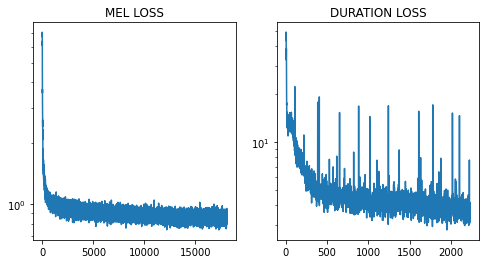

In [ ]:
EMBEGGING_SIZE = 256
NUM_EPOCHS = 90
LEARNING_RATE = 3e-4
WEIGHT_DECAY = 1e-6
BATCH_SIZE = 64
CLIP_VALUE = .8
CLIP_GRADS = True
ADD_SCHEDULER = True
USE_AMSGRAD = True
EXP_NAME = f'basedurian_LR={LEARNING_RATE}_BATCH_SIZE={BATCH_SIZE}_ADD_SCHEDULER={ADD_SCHEDULER}_CLIP_GRADS={CLIP_GRADS}_CLIP_VAL_{CLIP_VALUE}_WD={WEIGHT_DECAY}_AMSGRAD={USE_AMSGRAD}' + datetime.strftime(datetime.now(), '%d.%m.%Y_%H:%M:%S')

base_durian = train(
    n_epochs=NUM_EPOCHS, 
    bs=BATCH_SIZE, 
    lr=LEARNING_RATE, 
    wd=WEIGHT_DECAY, 
    exp_name=EXP_NAME, 
    add_scheduler=ADD_SCHEDULER, 
    clip_grads=CLIP_GRADS,
    continue_from_checkpoint=False,
    use_amsgrad=USE_AMSGRAD
    )


In [ ]:
class AdvancedDurIAN(nn.Module):

    def get_mask(self, pad_lengths, max_length):
        #pad_lengths - [bs]
        bs = pad_lengths.shape[0]
        buf = torch.arange(max_length).repeat(bs).reshape(bs, max_length)
        pad_mask = buf < pad_lengths.reshape(-1, 1)
        pad_mask = pad_mask.to(device)
        return pad_mask

    def __init__(self):
        super().__init__()
        self.encoder = AdvancedEncoder(ADD_CBHG)
        self.duration_model = DurationModel()
        self.alignment_model = AlignmentModel()
        self.decoder = AdvancedDecoder(ADD_PRENET, ADD_ATTENTION)

    def forward(self, x, durations=None, pad_lengths=None):
        # x - [bs, seq_len]
        # durations - [bs, seq_len]
        x_encoded = self.encoder(x) # [bs, seq_len, 2*emb_size]

        durations_predicted = self.duration_model(x) # [bs, seq_len]
        if durations is None:
            durations = durations_predicted.clamp_min(1).round().long()

        x_aligned = self.alignment_model(x_encoded, durations)  # [bs, number_of_frames, 2*emb_size+1]
        if pad_lengths is not None:
            mask = self.get_mask(pad_lengths, x_aligned.shape[1]) 
            #mask is of shape [bs, seq_len]
        else:
            mask = None
            
        mel1, mel2 = self.decoder(x_aligned, mask) # [bs, 80, number_of_frames],  [bs, 80, number_of_frames]
        return mel1, mel2, durations_predicted

class AdvancedEncoder(nn.Module):

    def __init__(self, add_cbhg):
        super().__init__()
        self.embedding = nn.Embedding(len(lj_speech.POSSIBLE_PHONEME_CODES), EMBEGGING_SIZE)
        self.add_cbhg = add_cbhg

        if add_cbhg:
            self.convresblock_list = nn.Sequential(
                ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=.5),
                ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=.5),
                ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=.5),
                ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=.5),
                ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=.5),
            )
            self.cbhg = CBHG()
        else:
            self.convresblock_list = nn.Sequential(
                ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=.5),
                ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=.5),
                ConvResBlock(EMBEGGING_SIZE, 2*EMBEGGING_SIZE, kernel_size=5, dropout_rate=.5),
                ConvResBlock(2*EMBEGGING_SIZE, 2*EMBEGGING_SIZE, kernel_size=5, dropout_rate=.5),
                ConvResBlock(2*EMBEGGING_SIZE, 2*EMBEGGING_SIZE, kernel_size=5, dropout_rate=.5),
            )
            self.bi_gru = nn.GRU(2*EMBEGGING_SIZE, EMBEGGING_SIZE, batch_first=True, bidirectional=True)


    def forward(self, x):
        # [bs, seq_len]
        x = self.embedding(x) # [bs, seq_len, emb_size]
        x = torch.transpose(x, 1, 2) # [bs, emb_size, seq_len]
        x = self.convresblock_list(x) #[bs, 2*emb_size or emb_size, seq_len]
        x = torch.transpose(x, 1, 2) # [bs, seq_len, 2*emb_size or emb_size]

        if self.add_cbhg:
            x = self.cbhg(x)
        else:
            x, _ = self.bi_gru(x) # [bs, seq_len, 2*emb_size]
        return x

class AdvancedDecoder(nn.Module):
    def __init__(self, add_prenet=False, add_attention=False):
        super().__init__()

        self.add_prenet = add_prenet
        if add_prenet:
            self.prenet = nn.Sequential(
                ConvResBlock(2*EMBEGGING_SIZE+1, 2*EMBEGGING_SIZE, kernel_size=5, dropout_rate=0.5),
                ConvResBlock(2*EMBEGGING_SIZE, 2*EMBEGGING_SIZE, kernel_size=5, dropout_rate=0.5),
                ConvResBlock(2*EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=0.5),
                ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=0.5),
                ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=0.5),
            )
        else:
            self.prenet = ConvResBlock(2*EMBEGGING_SIZE+1, EMBEGGING_SIZE, kernel_size=5, dropout_rate=0.5)
        
        self.add_attention = add_attention
        if add_attention:
            self.attention = MultiHeadAttentionLayer()
            self.attention_layer_norm = nn.LayerNorm(EMBEGGING_SIZE)
            self.dropout = nn.Dropout(DROPOUT_ATTENTION)
            

        self.gru = nn.GRU(EMBEGGING_SIZE, EMBEGGING_SIZE, num_layers=2, batch_first=True)

        self.conv1 = nn.Conv1d(EMBEGGING_SIZE, MEL_NB_FREQUENCIES, kernel_size=1)
        self.post_net = nn.Sequential(
            ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=DROPOUT_DECODER_POSTNET),
            ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=DROPOUT_DECODER_POSTNET),
            ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=DROPOUT_DECODER_POSTNET),
            ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=DROPOUT_DECODER_POSTNET),
            ConvResBlock(EMBEGGING_SIZE, EMBEGGING_SIZE, kernel_size=5, dropout_rate=DROPOUT_DECODER_POSTNET),
        )
        self.conv2 = nn.Conv1d(EMBEGGING_SIZE, MEL_NB_FREQUENCIES, kernel_size=1)

    def forward(self, x, mask=None):
        # x - [bs, number_of_frames, 2*emb_size+1]
        x = torch.transpose(x, 1, 2)
        x = self.prenet(x)
        x = torch.transpose(x, 1, 2) # x - [bs, number_of_frames, 2*emb_size+1]

        if self.add_attention:
            x_attention = self.attention(x, x, x, mask)
            x_attention = self.dropout(x_attention)
            x = x + x_attention
            x = self.attention_layer_norm(x)

        x, _ = self.gru(x) # [bs, number_of_frames, emb_size]

        x = torch.transpose(x, 1, 2) #[bs, emb_size, number_of_frames]
        x1 = self.conv1(x) #[bs, 80, number_of_frames]
        #x1 = torch.log10(torch.sigmoid(x1))
        x2 = self.post_net(x) #[bs, emb_size, number_of_frames]
        x2 = self.conv2(x2) #[bs, 80, number_of_frames]
        #x2 = torch.log10(torch.sigmoid(x2))
        return x1, x2

In [ ]:
class MultiHeadAttentionLayer(nn.Module):
    def __init__(self):
        super().__init__()
        
        assert EMBEGGING_SIZE % N_HEADS == 0, "hid_dim must be divisible by n_heads"
        
        self.hid_dim = EMBEGGING_SIZE
        self.n_heads = N_HEADS
        self.head_dim = EMBEGGING_SIZE // N_HEADS
        
        # query, key and value linear networks
        self.fc_q = nn.Linear(EMBEGGING_SIZE, EMBEGGING_SIZE)
        self.fc_k = nn.Linear(EMBEGGING_SIZE, EMBEGGING_SIZE)
        self.fc_v = nn.Linear(EMBEGGING_SIZE, EMBEGGING_SIZE)
        
        # output linear networks
        self.fc_o = nn.Linear(EMBEGGING_SIZE, EMBEGGING_SIZE)
        
        # dropout is applied to attention
        self.dropout = nn.Dropout(DROPOUT_ATTENTION)
        
        # scale parameter
        self.scale = torch.sqrt(torch.tensor(self.head_dim, dtype=torch.float32))
        
    def forward(self, query, key, value, mask=None):
        """
        query/key/value (batch of queries/keys/values): torch.float32 tensor of shape [bs, seq_len, hid_dim]
        mask (mask of valid elements): torch.bool tensor of shape [bs, seq_len]
        
        returns (multi-head attention): torch.float32 tensor of shape [bs, seq_len, hid_dim]
        """
        
        bs = query.shape[0]
        seq_len = query.shape[1]
        
        # calculate Q, K, V using corresponding linear networks
        q, k, v = self.fc_q(query), self.fc_k(key), self.fc_v(value)  # shape is [bs, seq_len, hid_dim]
                
        # prepare Q, K, V for .matmul() or `@` operator
        # shape is [bs, n_heads, seq_len, head_dim]
        q, k, v = q.reshape(bs, seq_len, self.n_heads, self.head_dim), k.reshape(bs, seq_len, self.n_heads, self.head_dim), v.reshape(bs, seq_len, self.n_heads, self.head_dim)

        q, k, v = torch.transpose(q, 1, 2), torch.transpose(k, 1, 2), torch.transpose(v, 1, 2),
        kt = torch.transpose(k, 2, 3)

        # compute energy using .matmul() or `@` operator (don't forget to scale!)
        # shape is [bs, n_heads, seq_len, seq_len]
        energy = torch.matmul(q, kt)/self.scale
        
        # apply mask – 1 in mask is a valid element, 0 - not (use .masked_fill())
        if mask is not None:
            r_mask = mask.unsqueeze(1).unsqueeze(1).expand_as(energy)
            energy = energy.masked_fill(torch.logical_not(r_mask), 0)
        
        # apply softmax along the last dim of energy and get the attention weights
        # shape is [bs, n_heads, seq_len]
        attention = torch.softmax(energy, dim=3) ## your code here
        attention = self.dropout(attention)

        # weight values with calculated attention (use .matmul() or `@` operator)
        # shape is [bs, n_heads, seq_len, head_dim]
        x = torch.matmul(attention, v)
        
        # squash 1 and 4 dims back
        x = x.permute(0, 2, 1, 3).contiguous()
        x = x.view(bs, -1, self.hid_dim)  # shape is [bs, seq_len, hid_dim]
        
        # apply output linear layer
        x = self.fc_o(x)
        
        return x

In [ ]:
#CBHG 
#thx to https://github.com/r9y9/tacotron_pytorch/blob/master/tacotron_pytorch/tacotron.py

class Highway(nn.Module):
    def __init__(self, in_size, out_size):
        super(Highway, self).__init__()
        self.H = nn.Linear(in_size, out_size)
        self.H.bias.data.zero_()
        self.T = nn.Linear(in_size, out_size)
        self.T.bias.data.fill_(-1)
        self.relu = nn.ReLU()
        self.sigmoid = nn.Sigmoid()

    def forward(self, inputs):
        H = self.relu(self.H(inputs))
        T = self.sigmoid(self.T(inputs))
        return H * T + inputs * (1.0 - T)

class BatchNormConv1d(nn.Module):
    def __init__(self, in_dim, out_dim, kernel_size, stride, padding,
                 activation=None):
        super(BatchNormConv1d, self).__init__()
        self.conv1d = nn.Conv1d(in_dim, out_dim,
                                kernel_size=kernel_size,
                                stride=stride, padding=padding, bias=False)
        self.bn = nn.BatchNorm1d(out_dim)
        self.activation = activation

    def forward(self, x):
        x = self.conv1d(x)
        if self.activation is not None:
            x = self.activation(x)
        return self.bn(x)

class CBHG(nn.Module):
    """CBHG module: a recurrent neural network composed of:
        - 1-d convolution banks
        - Highway networks + residual connections
        - Bidirectional gated recurrent units
    """

    def __init__(self, in_dim=EMBEGGING_SIZE, K=8, projections=[EMBEGGING_SIZE, EMBEGGING_SIZE]):
        super(CBHG, self).__init__()
        self.in_dim = in_dim
        self.relu = nn.ReLU()
        self.conv1d_banks = nn.ModuleList(
            [BatchNormConv1d(in_dim, in_dim, kernel_size=k, stride=1,
                             padding=k // 2, activation=self.relu)
             for k in range(1, K + 1)])
        self.max_pool1d = nn.MaxPool1d(kernel_size=2, stride=1, padding=1)

        in_sizes = [K * in_dim] + projections[:-1]
        activations = [self.relu] * (len(projections) - 1) + [None]
        self.conv1d_projections = nn.ModuleList(
            [BatchNormConv1d(in_size, out_size, kernel_size=3, stride=1,
                             padding=1, activation=ac)
             for (in_size, out_size, ac) in zip(
                 in_sizes, projections, activations)])

        self.pre_highway = nn.Linear(projections[-1], in_dim, bias=False)
        self.highways = nn.ModuleList(
            [Highway(in_dim, in_dim) for _ in range(4)])

        self.gru = nn.GRU(
            in_dim, in_dim, 1, batch_first=True, bidirectional=True)

    def forward(self, inputs, input_lengths=None):
        # (B, T_in, in_dim)
        x = inputs

        # Needed to perform conv1d on time-axis
        # (B, in_dim, T_in)
        if x.size(-1) == self.in_dim:
            x = x.transpose(1, 2)

        T = x.size(-1)

        # (B, in_dim*K, T_in)
        # Concat conv1d bank outputs
        x = torch.cat([conv1d(x)[:, :, :T] for conv1d in self.conv1d_banks], dim=1)
        assert x.size(1) == self.in_dim * len(self.conv1d_banks)
        x = self.max_pool1d(x)[:, :, :T]

        for conv1d in self.conv1d_projections:
            x = conv1d(x)

        # (B, T_in, in_dim)
        # Back to the original shape
        x = x.transpose(1, 2)

        if x.size(-1) != self.in_dim:
            x = self.pre_highway(x)

        # Residual connection
        x += inputs
        for highway in self.highways:
            x = highway(x)


        # (B, T_in, in_dim*2)
        outputs, _ = self.gru(x)
        return outputs


In [ ]:
def train_advanced(n_epochs, bs, lr, wd, exp_name, add_scheduler=True, clip_grads=True, continue_from_checkpoint=False, use_amsgrad=False):
    best_model_path = 'AdvancedDurian_best.pth'
    best_val_loss = float('+inf')
    train_dataloader = torch.utils.data.DataLoader(true_train_dataset, batch_size=bs, collate_fn=pad_collate, shuffle=True, num_workers=4)
    val_dataloader = torch.utils.data.DataLoader(true_val_dataset, batch_size=bs, collate_fn=pad_collate, num_workers=4)

    model = AdvancedDurIAN().to(device)
    if continue_from_checkpoint:
        model.load_state_dict(torch.load(best_model_path))

    optimizer = torch.optim.Adam([p for p in model.encoder.parameters()] + [p for p in model.decoder.parameters()], lr=lr, weight_decay=wd, amsgrad=use_amsgrad)
    dur_optimizer = torch.optim.Adam(model.duration_model.parameters(), lr=lr, weight_decay=wd, amsgrad=use_amsgrad)
   
    if add_scheduler:
        scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, [60, 80], 0.1)
    writer = SummaryWriter(os.path.join(log_dir, exp_name))

    mel_loss_history = []
    dur_loss_history = []

    for epoch in range(n_epochs):

        #training
        model.train()
        for i, batch in enumerate(train_dataloader):
            phoneme_batch, duration_batch, mel_batch, pad_lengths, dur_lengths = batch
            phoneme_batch, duration_batch, mel_batch = phoneme_batch.to(device), duration_batch.to(device), mel_batch.to(device)

            mel1, mel2, duration_predicted = model(phoneme_batch, duration_batch, pad_lengths)
           
            mel_loss = calculate_mel_loss(mel1, mel2, mel_batch, pad_lengths)
            mel_loss.backward()

            if epoch <= 10:
                dur_loss = calculate_dur_loss(duration_predicted, duration_batch, dur_lengths)
                  
            if clip_grads:
                gn = torch.nn.utils.clip_grad_norm_(model.parameters(), CLIP_VALUE)

            if epoch <= 10:
                dur_loss.backward()     
                dur_optimizer.step()
                dur_optimizer.zero_grad()

            #doing optimization step
            optimizer.step()
            optimizer.zero_grad()

            #logging
            mel_loss_history.append(mel_loss.item())
            
            writer.add_scalar('gradient_norms/overall_gn', gn.item(), global_step=len(train_dataloader)*epoch+i)

            if epoch <= 10:
                dur_loss_history.append(dur_loss.item())
            
            writer.add_scalar('train/dur_loss', dur_loss.item(), global_step=len(train_dataloader)*epoch+i)            
            writer.add_scalar('train/mel_loss', mel_loss.item(), global_step=len(train_dataloader)*epoch+i)
            

            if i == 0:
                fig, ax = plt.subplots(1, 2, figsize=(8,4))
                ax[0].semilogy(mel_loss_history)
                ax[0].set_title('MEL LOSS')
                ax[1].semilogy(dur_loss_history)
                ax[1].set_title('DURATION LOSS')
                plt.show()
                display.clear_output(True)
        
        if add_scheduler:
            scheduler.step()
            

        #evaluating
        model.eval()
        val_mel_loss_overall = 0.
        val_dur_loss_overall = 0.
        total = 0
        with torch.no_grad():
            for i, batch in enumerate(val_dataloader):
                phoneme_batch, duration_batch, mel_batch, pad_lengths, dur_lengths = batch
                phoneme_batch, duration_batch, mel_batch = phoneme_batch.to(device), duration_batch.to(device), mel_batch.to(device)

                mel1, mel2, duration_predicted = model(phoneme_batch, duration_batch, pad_lengths)

                mel_loss = calculate_mel_loss(mel1, mel2, mel_batch, pad_lengths)
                dur_loss = calculate_dur_loss(duration_predicted, duration_batch, dur_lengths)

                val_mel_loss_overall += mel_loss.item()*len(phoneme_batch)
                val_dur_loss_overall += dur_loss.item()*len(phoneme_batch)
                total += len(phoneme_batch)

        val_mel_loss_overall /= total
        val_dur_loss_overall /= total

        torch.save(model.state_dict(), best_model_path)

        writer.add_scalar('val/mel_loss', val_mel_loss_overall, global_step=epoch)
        if epoch <= 10:
            writer.add_scalar('val/dur_loss', val_dur_loss_overall, global_step=epoch)

        #capturing audio
        write_audio(writer, model, epoch)
    return model

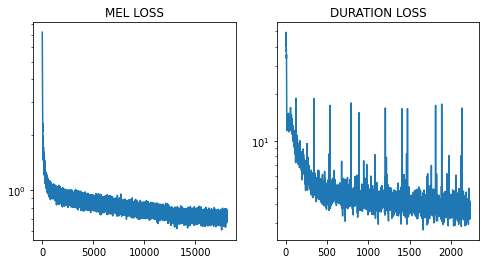

In [ ]:
EMBEGGING_SIZE = 256
NUM_EPOCHS = 90
LEARNING_RATE = 3e-4
WEIGHT_DECAY = 1e-6
BATCH_SIZE = 64
CLIP_VALUE = .8
CLIP_GRADS = True
ADD_SCHEDULER = True
USE_AMSGRAD = False

ADD_PRENET = True
ADD_CBHG = True
ADD_ATTENTION = True
N_HEADS = 4
DROPOUT_DECODER_POSTNET = 0.
DROPOUT_ATTENTION = .5



EXP_NAME = f'AdvancedDurian_LR={LEARNING_RATE}_BATCH_SIZE={BATCH_SIZE}_ADD_SCHEDULER={ADD_SCHEDULER}_CLIP_GRADS={CLIP_GRADS}_CLIP_VAL_{CLIP_VALUE}_WD={WEIGHT_DECAY}_AMSGRAD={USE_AMSGRAD}' + datetime.strftime(datetime.now(), '%d.%m.%Y_%H:%M:%S')

advanced_durian = train_advanced(
    n_epochs=NUM_EPOCHS, 
    bs=BATCH_SIZE, 
    lr=LEARNING_RATE, 
    wd=WEIGHT_DECAY, 
    exp_name=EXP_NAME, 
    add_scheduler=ADD_SCHEDULER, 
    clip_grads=CLIP_GRADS,
    continue_from_checkpoint=False,
    use_amsgrad=USE_AMSGRAD
    )



In [ ]:
!cp 'AdvancedDurian_best.pth' './drive/My Drive/AdvancedDurian_best.pth'
!cp 'BaselineDurIAN_best.pth' './drive/My Drive/BaselineDurIAN_best.pth'

In [ ]:
class TextToSpeechSynthesizer:
    """
    When done, please fill this class. It should work out-of-the-box, i.e.
    have a simple interface, automatically load model weights,
    process text to speech at one command without errors etc.
    """
    def __init__(self, checkpoint_path, mode='base', device='cuda'):
        """
        Initialize anything you may need. For example, load model weights from disk.
        """
        if mode == 'base':
            self.model = BaselineDurIAN()
        if mode == 'advanced':
            self.model = AdvancedDurIAN()
        
        self.model = self.model.to(device)
        self.model.eval()
        self.model.load_state_dict(torch.load(checkpoint_path))
        self.device = device
    
    def synthesize_from_text(self, text):
        """
        Synthesize text into voice.

        text:
            str
        
        return:
        audio:
            torch.Tensor or numpy.ndarray, shape == (1, t)
        """
        phonemes = lj_speech.text_to_phonemes(text)
        return self.synthesize_from_phonemes(phonemes)

    def synthesize_from_phonemes(self, phonemes, durations=None):
        """
        Synthesize phonemes into voice.

        phonemes:
            list of str
            ARPAbet phoneme codes.
        durations:
            list of int, optional
            Duration in spectrogram frames for each phoneme.
            If given, will be used for hard alignment in the model (like during
            training); otherwise, durations will be predicted by the duration
            model.
        
        return:
        audio:
            torch.Tensor or numpy.ndarray, shape == (1, t)
        """
        torch_phonemes = torch.LongTensor([phoneme2idx[phoneme] for phoneme in phonemes]).to(self.device)[None]
        if durations is not None:
            torch_durations = torch.LongTensor(durations).to(self.device)[None]
        else:
            torch_durations = None
        output = self.model(torch_phonemes, torch_durations)
        spectrogram = (output[0][0]+output[1][0]).detach().cpu()
        
        return vocoder(spectrogram)

In [ ]:
# Example:
synthesizer = TextToSpeechSynthesizer('AdvancedDurian_best.pth', mode='advanced')

In [ ]:
phonemes = "DH IH1 S pau pau pau IH1 Z pau pau pau S P AH1 R T AH1 AH1 AH1 pau".split()
lj_speech.play_audio(
    synthesizer.synthesize_from_phonemes(phonemes))

In [ ]:
#text = "Pack my box with five dozen liquor jugs."
#text = "The five boxing wizards jump quickly."
#text = "The quick brown fox jumps over the lazy dog."
#text = "How about some school tech."
text = "Last homework. We are in a deep trouble. No sleep tonight."

lj_speech.play_audio(
    synthesizer.synthesize_from_text(text))

### Report DL

Well, let’s start
For baseline model I tried several things:
1. Changing batch size (choose 64 as optimal value)
2. Changing learning rate of Adam. The best was 3e-4 (thx to Carpathy)
3. Use amsgrad  in Adam (quality decreased)
4. Using Scheduler with different strategies. Final choice - MultiStepLR, with steps after epoch 60, and 80. Really helped
5. Weight decay. It helped. Weight decay = 1e-6.
6. 90 epochs seems enough
7. Changing activations after final convolution predicting Mel spectrogram to torch.log10(torch.sigmoid(output)). I thought it would be good idea coz original values are dethibels. No significant changes noticed.
8. I wanted to try some kind-of data augmentation trick: during training randomly choose with which duration (ground truth or predicted), decoder should output spectrograms. But there was problem with batch tensor dimensions  compatibility, so I have not succeeded in implementing it.
9. I tried increasing EMBEDDING_SIZE to 512. I know it’s illegal, but anyway, it did not help
10. I tried to play with clipping grad norm. Firstly I just choose clipping values from related articles. Then, I decided to plot grad norm plot, and found out peak values. I chose CLIPPING VALUE = .8.
11. I compared quality of audio with both ground truth durations inference, and predicted inference durations.

After all of these experiments, I managed to get audio not worse than ‘ok.wav’ according to independent accessor (my girlfriend). But anyway it’s very interesting for me how you will measure ‘quality’ of audio.

As training of baseline model took hell a lot of time, I could not spend much time on just ‘grid searching’ of best improvements. So I needed to come up with IN-MY-MIND GRID SEARCH:
Here are my thoughts:
1. They use CBHG in original DURIAN paper, so I definitely should use it in my network (with hyperparameters from Tacotron paper)
2. I was confused but not using prenet in decoder in baseline model, and it felt very right to use it in advanced model. 
3. I implemented multi head attention layer, and to understand this concept more deeply I should use it in part 2. 
4. I don’t have time to write other stuff.
So, yeah, that’s how I decided to do these 3 significant changes: add prenet to decoder, add attention to decoder, add CBHG to encoder.

After some debugging, I finally launched training of advanced model. Firstly, it behaved ‘just a little bit’ better than original model, and I said ‘hmm, ok, at least some improvements’. Then, it started overfit  - mel spectrogram loss on training is decreasing, while validation loss is going up. I said ‘oh, no, I made very shitty model’. BUT. Then I tried to listen to audio samples, and was shocked:  advanced_durian reproduced very well not only training audio, but also VALIDATION audio. Validation loss was growing, validation audio ‘quality’ was increasing. Independent assessor (my girlfriend) was also shocked.
I tried to explain this phenomenon and come up with just one explanation, that MSE loss is not representative for task of speech synthesis. E.g. in Image generation MSE loss tends to desaturate colours. I guess in speech generation such ‘desaturated colours’ are metallic voices.

Anyways, It was really fun and challenging homework, that was the hardest model I’ve ever built in my life.

But for me the most important lesson from this homework is that It’s REALLY convenient when all hyperparameters I tune, are situated in one cell. 

See you at project defence!


